* Image data augmentation is a technique that can be used to artificially expand the size of a training dataset by creating modified versions of images in the dataset.


* Training deep learning neural network models on more data can result in more skillful models, and the augmentation techniques can create variations of the images that can improve the ability of the fit models to generalize what they have learned to new images.


* The Keras deep learning neural network library provides thecapability to fit models using image data augmentation via the ImageDataGenerator class.


* The types of augmentation that we should or could apply on the data is domain driven.

# Tensorflow.Keras Image Augmentation

## Imports

In [1]:
import numpy as np
from numpy import expand_dims

import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import matplotlib.pyplot as plt
%matplotlib inline

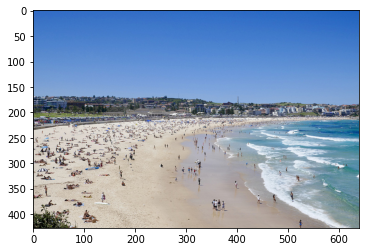

In [2]:
# load image and plot image
image = load_img("./images/bondi_beach.jpg")
plt.imshow(image)

In [3]:
# convert to numpy array
img_arr = img_to_array(image)
img_arr.shape

(427, 640, 3)

In [4]:
# expand image dimension to add 1 sample
sample = expand_dims(img_arr, 0)
sample.shape

(1, 427, 640, 3)

Images fed into the CNN should be normalized single: 
A large number of image augmentations can be performed on the images. Most common include:
* horizontal flip   - (True/False)
* vertical flip     - (True/False)
* rotation_range    - Int. Degree range for random rotations
* width_shift_range - if < 1.0 (fraction of total width), if  int()
* height_shift_range
* brightness_range  - Tuple or list of two floats. Range for picking a brightness shift value from
* shear_range       - float. Shear Intensity (Shear angle in counter-clockwise direction in degrees)
* zoom_range        - Float or [lower, upper]. Range for random zoom. If a float, [lower, upper] = [1-zoom_range,1+zoom_range]

In addition to these commonly applied augmentation: 
* featurewise_center            - Boolean. Set input mean to 0 over the dataset, feature-wise.
* samplewise_center             - Boolean. Set each sample mean to 0.
* featurewise_std_normalization - Boolean. Divide inputs by std of the dataset, feature-wise.
* samplewise_std_normalization  - Boolean. Divide each input by its std.

In [5]:
# Create image data augmentation generator
datagen = ImageDataGenerator(rotation_range=90,
                             horizontal_flip=True,
                             vertical_flip=True,
                             )

In [6]:
# prepare iterator
it = datagen.flow(sample, batch_size=1)

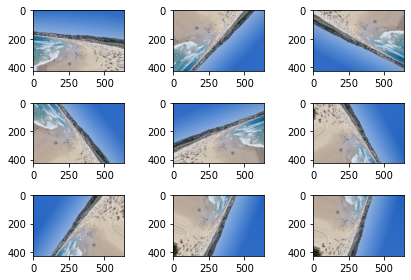

In [7]:
for i in range(9):
    # define subplot
    plt.subplot(330+1 +i)
    batch = it.next()
    image = batch[0].astype('uint8')
    plt.imshow(image)
plt.tight_layout()
plt.show()

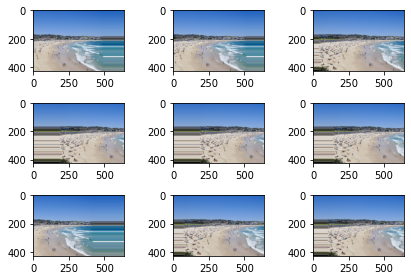

In [8]:
# Create image data augmentation generator
datagen_02 = ImageDataGenerator(width_shift_range=0.4)

# prepare iterator
it = datagen_02.flow(sample, batch_size=1)

for i in range(9):
    plt.subplot(330+1+i)
    batch = it.next()
    image= batch[0].astype("uint8")
    plt.imshow(image)
plt.tight_layout()
plt.show()

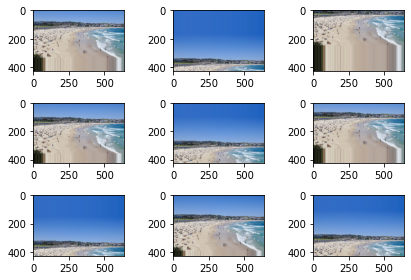

In [9]:
# Create image data augmentation generator
datagen_03 = ImageDataGenerator(height_shift_range=0.5)

# prepare iterator
it = datagen_03.flow(sample, batch_size=1)

for i in range(9):
    plt.subplot(330+1+i)
    batch = it.next()
    image= batch[0].astype("uint8")
    plt.imshow(image)
plt.tight_layout()
# plt.show()

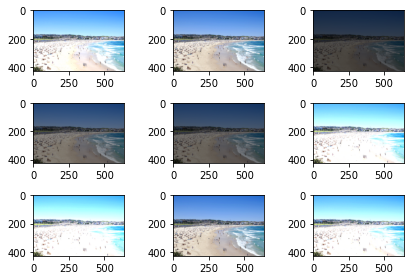

In [10]:
# Image Data Generator
datagen_04 = ImageDataGenerator(brightness_range=(0.1,2.))

# iterator
it = datagen_04.flow(sample, batch_size=1)

for i in range(9):
    plt.subplot(330+1+i)
    batch = it.next()
    image = batch[0].astype("uint8")
    plt.imshow(image)
plt.tight_layout()
plt.show()

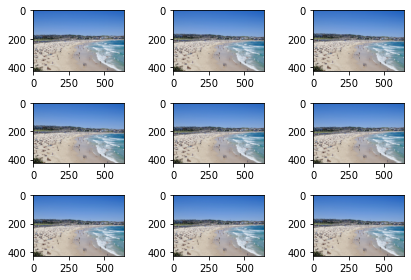

In [11]:
datagen_05 = ImageDataGenerator(shear_range=1.6)
# iterator
it = datagen_05.flow(sample, batch_size=1)

for i in range(9):
    plt.subplot(330+1+i)
    batch=it.next()
    image=batch[0].astype("uint8")
    plt.imshow(image)
plt.tight_layout()
plt.show()

# ImageAugmentation Library

In addition to the keras image augmentation, external libraries aslo exist that can we used in conjunction with the keras image augmentation. ImgAug is one such library that we can use. Let's explore it a bit below. The code below is borrowed from the notes on the library website and much more information can be found on the [website](https://imgaug.readthedocs.io/en/latest/source/overview/blur.html#medianblur)


An augmentation sequence (crop + horizontal flips + gaussian blur + motion blur) is defined once at the start of the script. Then many batches are loaded and augmented before being used for training.

In [12]:
import imageio
import imgaug as ia
import imgaug.augmenters as iaa

We will use imageio.imread() to load an image and augment it.
In the code block below, we call imageio.imread(path_to_image) to load an image from a filepath. We can also load it  from a website. 

Original image:


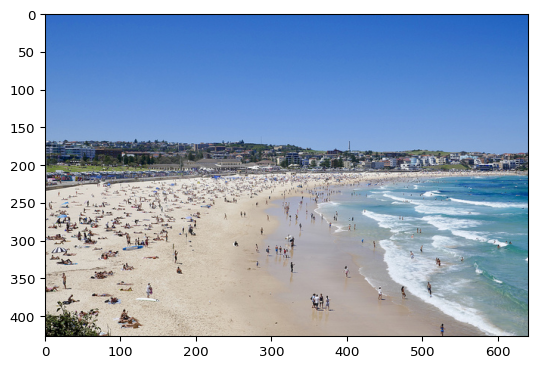

In [13]:
image = imageio.imread("./images/bondi_beach.jpg") # takes an image uri or a path
print("Original image:")
ia.imshow(image)

## Augment the Image

Now that we have loaded the image, let's augment it. 

imgaug contains many augmentation techniques in the form of classes deriving from the Augmenter parent class. 

To use one augmentation technique, we have to instantiate it with a set of hyperparameters and then later on apply it many times.

Our first augmentation technique will be Affine, i.e. affine transformations. We keep it simple here and use that technique to rotate the image by a random value between -25° and +25°.

### Affine - Rotate

Augmented: 


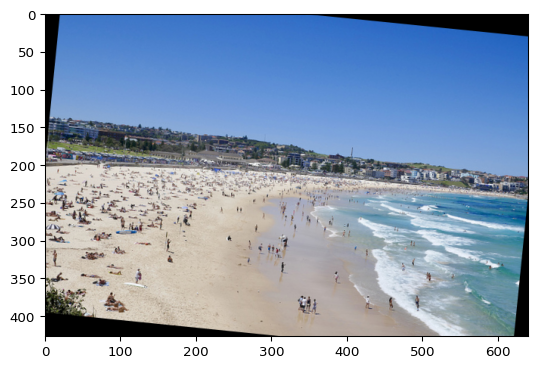

In [14]:
from imgaug import augmenters as iaa
ia.seed(4)
# Step 1: instantiate the augmenter, in this case Affine, with some hyperparameters, degrees of rotation
rotate = iaa.Affine(rotate=(-60, 60)) # to make it dramatic
img_aug = rotate(image = image)

print("Augmented: ")
ia.imshow(img_aug)

**Lists of images or a single array.** Note that in the example below we used a list to combine our images to one batch. We could have also provided a single numpy array of shape (N, H, W, [C]), where N would have been the number of images, H their height, W their width and C (optionally) the channel-axis. Using numpy arrays is generally preferred, as they save memory and can be a little bit faster to augment. However, if your images have different heights, widths or numbers of channels they cannot be combined to a single array and hence a list must be used.

Augmented Images:


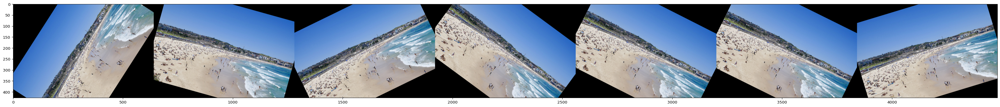

In [15]:
images = [image, image, image, image, image, image, image]
img_aug = rotate(images=images)

print("Augmented Images:")
ia.imshow(np.hstack(img_aug))

* All of the images in the batch were automatically rotated by different amounts. 

* In our affine transformation via rotate = iaa.Affine(rotate=(-25, 25)), we used an interval for the rotation, given as (-25, 25), which denotes a uniform distribution rotate ~ uniform(-25, 25). 

* We could have also picked a constant value rotate=-25 to always rotate by -25° or 

* a list rotate=[-25, -15, 0] to rotate by -25° or by -15° or by 0°. 

* We could have also pick many other probability distributions, such as gaussian or poisson distributions. 

### Additive Gaussian 

Image with Gaussian Noise:


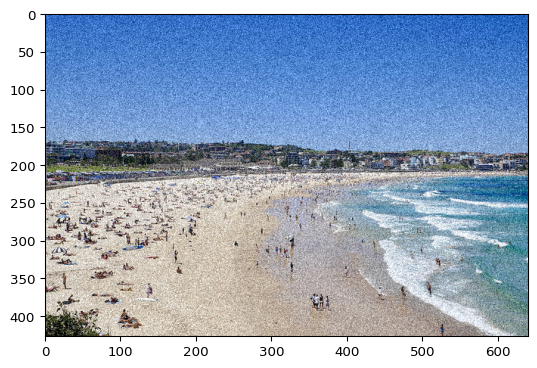

In [16]:
# Step 1: Instantiate
gaussian_noise = iaa.AdditiveGaussianNoise(scale=(10,60))
img_aug = gaussian_noise(image=image)
print("Image with Gaussian Noise:")
ia.imshow(img_aug)

Images with Gaussian Noise:


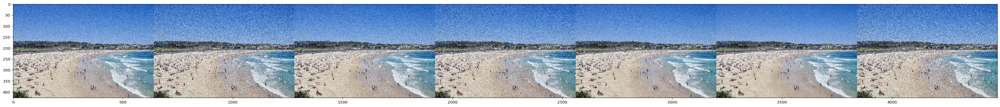

In [17]:
imgs_aug = gaussian_noise(images = images)
print("Images with Gaussian Noise:")
ia.imshow(np.hstack(imgs_aug))

### Flip image(s)

Image flipped left to right (horizontally):


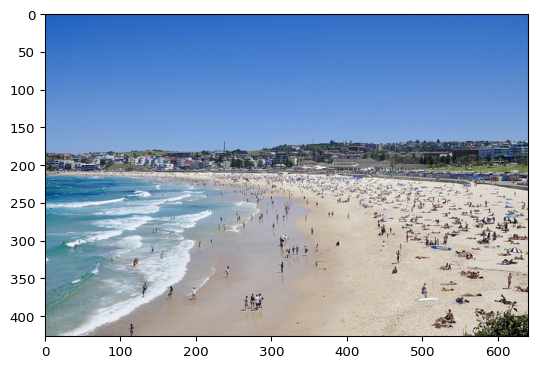

In [18]:
# Instantiate Fliplr
flip_lr = iaa.Fliplr(p=1.0) # p=probability
img_aug = flip_lr(image=image)
print("Image flipped left to right (horizontally):")
ia.imshow(img_aug)

Images flipped left to right (horizontally):


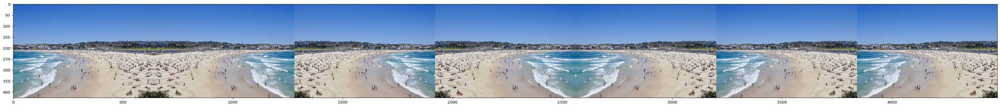

In [19]:
flip_lr = iaa.Fliplr(p=0.5) # p=probability
imgs_aug = flip_lr(images=images)
print("Images flipped left to right (horizontally):")
ia.imshow(np.hstack(imgs_aug))

Image flipped up down(vertically):


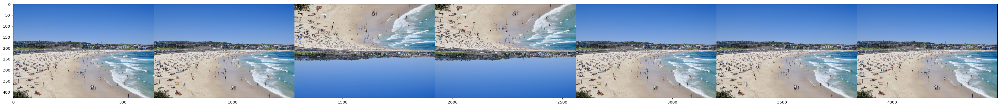

In [20]:
flip_ud = iaa.Flipud(p=0.5) # p=probability
imgs_aug = flip_ud(images=images)
print("Image flipped up down(vertically):")
ia.imshow(np.hstack(imgs_aug))

### Crop

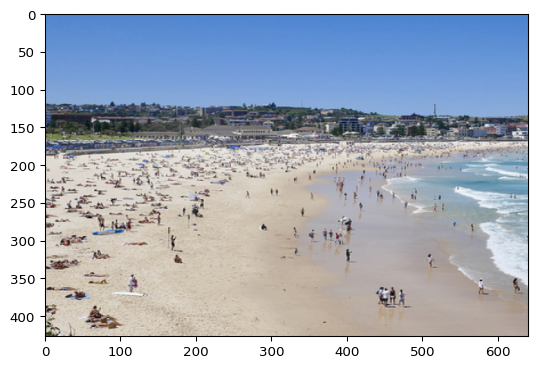

In [21]:
# Instantiate
crop = iaa.Crop(percent=(0, 0.3))

img_aug = crop(image=image)
ia.imshow(img_aug)

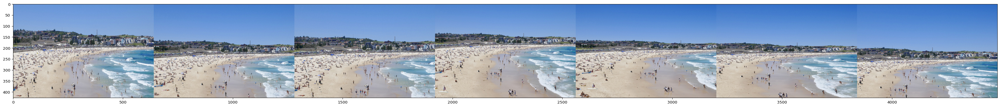

In [22]:
imgs_aug = crop(images=images)
ia.imshow(np.hstack(imgs_aug))

## Use Many Augmentation Techniques Simultaneously

We can combine several methods and apply them simultaneously to images. To do that, we could instantiate each technique on its own and apply them one after the other by calling augmenter(images=...) several times.

Alternatively, we can use **Sequential** to combine the different augmenters into one pipeline and then apply them all in a single augmentation call. We will use Sequential below to apply affine rotations (Affine), add some gaussian noise (AdditiveGaussianNoise) and crop the images by removing 0% to 20% from each image side (Crop).

Augmented images:


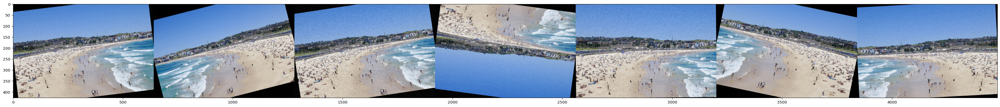

In [23]:
seq = iaa.Sequential(
    [iaa.Crop(percent=(0,0.2)),
     iaa.Fliplr(p=0.5),
     iaa.Flipud(p=0.1),
     iaa.Affine(rotate=(-20, 20)),
     iaa.GaussianBlur(sigma=(0.0, 0.3)),
     iaa.AdditiveGaussianNoise(scale=(0, 15))   
    ])

imgs_aug = seq(images=images)
print("Augmented images:")
ia.imshow(np.hstack(imgs_aug))

Some of the images could be zoomed in. This comes from Crop. Note also how all of the images still have the same size. This is because Crop by default retains the input image size, i.e. after removing pixels it resizes the remaining image back to the input size. If you instead prefer to not resize back to the original image size, instantiate Crop as Crop(..., keep_size=False), where keep_size denotes "keep the image sizes constant between input and output"

However, it does have one handy ability that we didn't use yet and that is random order augmenation. If activated, it applies augmentations in random order, greatly increasing the space of possible augmentations and saving us from having to implement that ourselves.

In the next example we will use that ability. It is as simple as just adding random_order=True to Sequential. To make things more visible, we increase the strength of the augmentations a bit and show more images. Note also how we augment the input image eight times via a loop instead of using a single call augmentation call for the whole batch. That is because the random order is sampled once per batch and not per image in the batch. To see many different orders here, we therefore augment several times.

Augmented images:


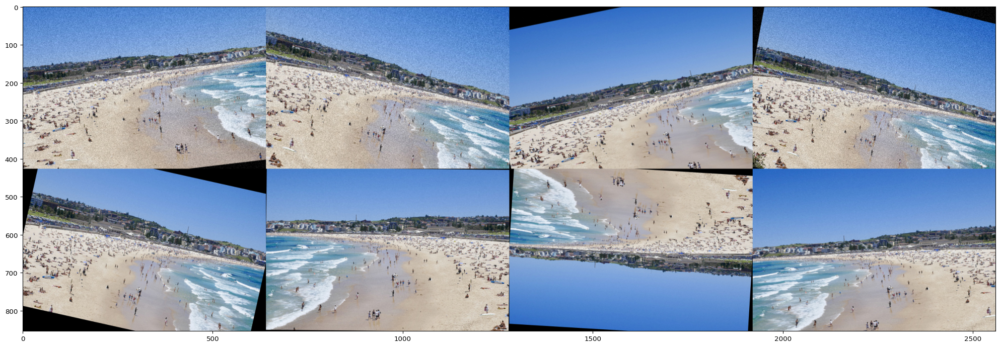

In [29]:
seq = iaa.Sequential(
    [iaa.Crop(percent=(0,0.2)),
     iaa.Fliplr(p=0.5),
     iaa.Flipud(p=0.1),
     iaa.Affine(rotate=(-20, 20)),
     iaa.GaussianBlur(sigma=(0.0, 0.3)),
     iaa.AdditiveGaussianNoise(scale=(0, 15))   
    ], random_order=True)

images_aug = [seq(image=image) for _ in range(8)]
print("Augmented images:")
ia.imshow(ia.draw_grid(images_aug, cols=4, rows=2))

## Augmenting Images of Different Sizes
It was already mentioned above that imgaug supports batches containing images with different sizes, but so far we have always used the same image. The following example shows a case with different image sizes. We load three images from the wikipedia, augment them as a single batch and then show each image one by one (with the input and output shape). We also use some different augmentation techniques this time.

Image 0 (input shape: (257, 286, 3), output shape: (257, 286, 3))


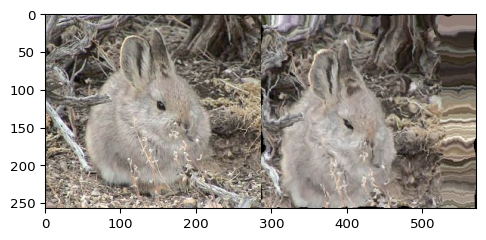

Image 1 (input shape: (536, 800, 3), output shape: (536, 800, 3))


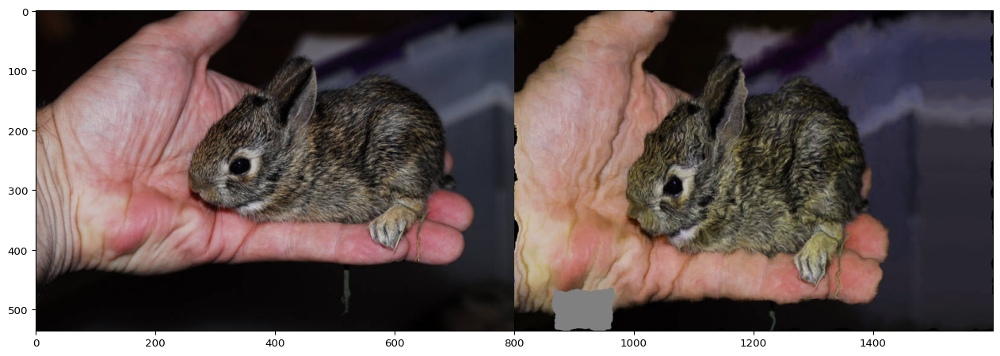

Image 2 (input shape: (289, 520, 3), output shape: (289, 520, 3))


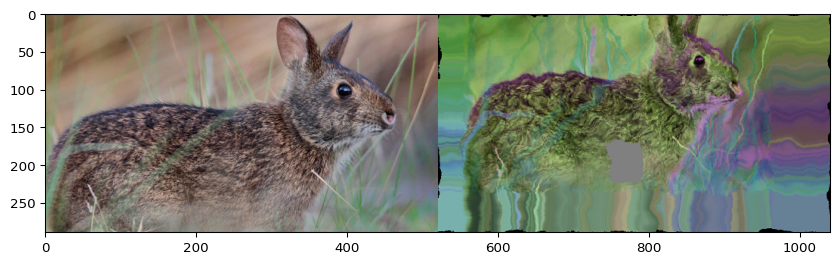

In [30]:
seq = iaa.Sequential([
    iaa.CropAndPad(percent=(-0.2, 0.2), pad_mode="edge"),  # crop and pad images
    iaa.AddToHueAndSaturation((-60, 60)),  # change their color
    iaa.ElasticTransformation(alpha=90, sigma=9),  # water-like effect
    iaa.Cutout()  # replace one squared area within the image by a constant intensity value
], random_order=True)

# load images with different sizes
images_different_sizes = [
    imageio.imread("https://upload.wikimedia.org/wikipedia/commons/e/ed/BRACHYLAGUS_IDAHOENSIS.jpg"),
    imageio.imread("https://upload.wikimedia.org/wikipedia/commons/c/c9/Southern_swamp_rabbit_baby.jpg"),
    imageio.imread("https://upload.wikimedia.org/wikipedia/commons/9/9f/Lower_Keys_marsh_rabbit.jpg")
]

# augment them as one batch
images_aug = seq(images=images_different_sizes)

# visualize the results
print("Image 0 (input shape: %s, output shape: %s)" % (images_different_sizes[0].shape, images_aug[0].shape))
ia.imshow(np.hstack([images_different_sizes[0], images_aug[0]]))

print("Image 1 (input shape: %s, output shape: %s)" % (images_different_sizes[1].shape, images_aug[1].shape))
ia.imshow(np.hstack([images_different_sizes[1], images_aug[1]]))

print("Image 2 (input shape: %s, output shape: %s)" % (images_different_sizes[2].shape, images_aug[2].shape))
ia.imshow(np.hstack([images_different_sizes[2], images_aug[2]]))

## Medical Images

In [ ]:
import imgaug.augmenters as iaa
aug = iaa.GaussianBlur(sigma=(0.0, 3.0))

import imgaug.augmenters as iaa
aug = iaa.MotionBlur(k=15)

iaa.Affine(translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)})

iaa.Affine(shear=(-16, 16))
aug = iaa.ShearX((-20, 20))
aug = iaa.ShearY((-20, 20))

In [ ]:
seq = iaa.Sequential(
    [iaa.Fliplr(p=0.5),
     iaa.Affine(rotate=(-20, 20)),
     iaa.GaussianBlur(sigma=(0.0, 0.3)),
     iaa.MotionBlur(k=15),
     iaa.AdditiveGaussianNoise(scale=(0, 15))   
    ], random_order=True)

## Using with Keras

In [31]:
from imgaug import augmenters as iaa

seq = iaa.Sequential([...])  # list of desired augmentors

ig = ImageDataGenerator(preprocessing_function=seq.augment_image)  # pass this as the preprocessing function

gen = ig.flow_from_directory(data_dir)  # nothing else changes with the generator